In [22]:
import spacy
import pandas as pd
import json
import os
import re
from tqdm.notebook import tqdm
from rake_nltk import Rake
from spacy.matcher import Matcher 
import en_core_web_sm
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np



In [23]:
directories = ['../data/biorxiv_medrxiv/', '../data/comm_use_subset/','../data/custom_license/', '../data/noncomm_use_subset/']

In [24]:
files = []
for directory in directories:
    for (dirpath, dirnames, filenames) in os.walk(directory):
        filenames = [names for names in filenames if '1.1.pickle' in names]
        if filenames != []:
            files.append({'dirpath':dirpath, 'filenames':filenames})

In [25]:
tri_df_list = []
for file in files:
    df = pd.read_pickle(file['dirpath']+file['filenames'][0])
    abstract_tripplets = df[['Abs Tri', 'ID', 'Task List']]
    for index, tri in abstract_tripplets.iterrows():
        tri_df = pd.read_json(tri['Abs Tri'])
        tri_df['ID'] = tri['ID']
        tri_df['Task List'] =  [tri['Task List']]*tri_df.shape[0]
        tri_df_list.append(tri_df)
        
tri_df = pd.concat(tri_df_list, ignore_index = True)

In [49]:
def create_kg(pairs):
    k_graph = nx.from_pandas_edgelist(pairs, 'subject', 'object',edge_attr = ['relation' ,'ID', 'Task List'],
            create_using=nx.MultiDiGraph())
    return k_graph

def draw_kg(k_graph):
    node_deg = nx.degree(k_graph)
    layout = nx.spring_layout(k_graph, k=0.25, iterations=20)
    plt.figure(num=None, figsize=(120, 90), dpi=80)
    nx.draw_networkx(
        k_graph,
        node_size=[int(deg[1]) * 500 for deg in node_deg],
        arrowsize=20,
        linewidths=1.5,
        pos=layout,
        edge_color='red',
        edgecolors='black',
        node_color='white',
        )
    
    subject = []
    obj = []
    relation = []
    tasks = []
    for element in list(k_graph.edges()):
        subject.append(element[0])
        obj.append(element[1])
        relation.append(k_graph.get_edge_data(element[0],element[1])[0]['relation'])
    labels = dict(zip(list(zip(subject, obj)),relation))
    nx.draw_networkx_edge_labels(k_graph, pos=layout, edge_labels=labels,
                                 font_color='red')
    plt.axis('off')
    plt.savefig('test_graph.png')
    #plt.show()
    

In [27]:
k_graph = create_kg(tri_df)

In [28]:
print(nx.info(k_graph))

Name: 
Type: MultiDiGraph
Number of nodes: 28997
Number of edges: 24879
Average in degree:   0.8580
Average out degree:   0.8580


In [18]:
node_rank = nx.degree_centrality(k_graph)

In [19]:
node_rank_sorted = {k: v for k, v in sorted(node_rank.items(), key=lambda item: item[1],reverse=True)}

In [20]:
top_nodes = [k for k in node_rank_sorted.keys()][1:1000]

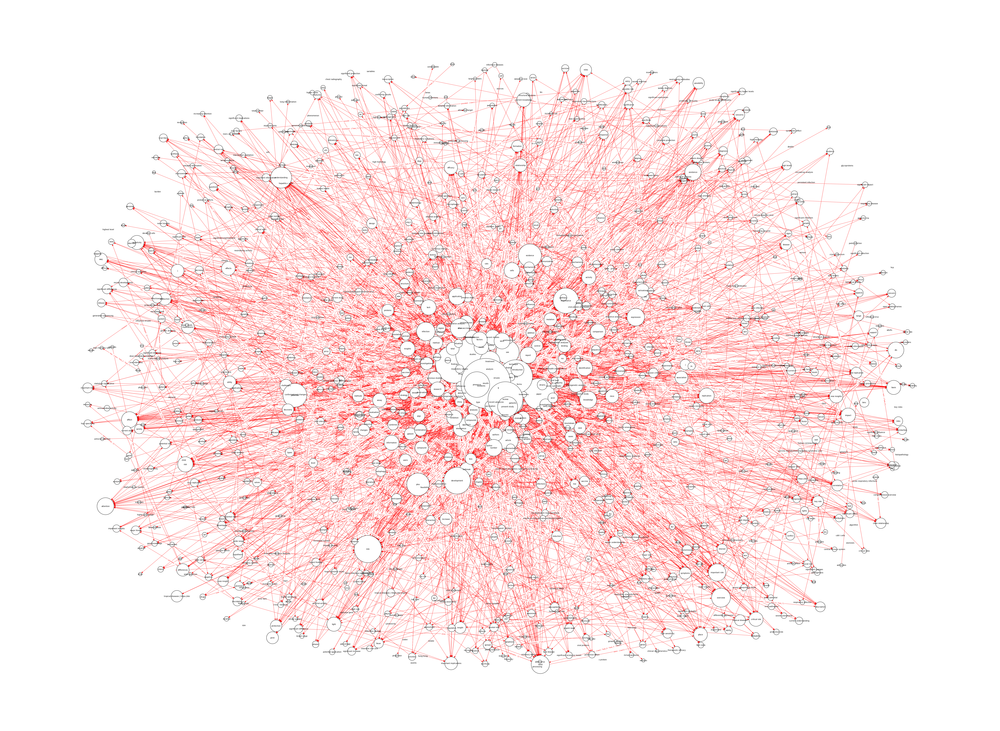

In [21]:
draw_kg(k_graph.subgraph(top_nodes))

## Task 1 Analysis
What is known about transmission, incubation, and environmental stability? What do we know about natural history, transmission, and diagnostics for the virus? What have we learned about infection prevention and control?

Specifically, we want to know what the literature reports about:

- Range of incubation periods for the disease in humans (and how this varies across age and health status) and how long individuals are contagious, even after recovery.
- Prevalence of asymptomatic shedding and transmission (e.g., particularly children).
- Seasonality of transmission.
- Physical science of the coronavirus (e.g., charge distribution, adhesion to hydrophilic/phobic surfaces, environmental survival to inform decontamination efforts for affected areas and provide information about viral shedding).
- Persistence and stability on a multitude of substrates and sources (e.g., nasal discharge, sputum, urine, fecal matter, blood).
- Persistence of virus on surfaces of different materials (e,g., copper, stainless steel, plastic).
- Natural history of the virus and shedding of it from an infected person
- Implementation of diagnostics and products to improve clinical processes
- Disease models, including animal models for infection, disease and transmission
- Tools and studies to monitor phenotypic change and potential adaptation of the virus
- Immune response and immunity
- Effectiveness of movement control strategies to prevent secondary transmission in health care and community settings
- Effectiveness of personal protective equipment (PPE) and its usefulness to reduce risk of transmission in health care and community settings
- Role of the environment in transmission

In [37]:
nodes = []
TASK = 'Task_1'
for edge in k_graph.edges():
    for k,row in k_graph.get_edge_data(edge[0],edge[1]).items():
        if TASK in row['Task List']:
            nodes.append(edge[0])
            nodes.append(edge[1])

In [40]:
task_1_graph = k_graph.subgraph(nodes)
print(nx.info(task_1_graph))

Name: 
Type: MultiDiGraph
Number of nodes: 1108
Number of edges: 1561
Average in degree:   1.4088
Average out degree:   1.4088


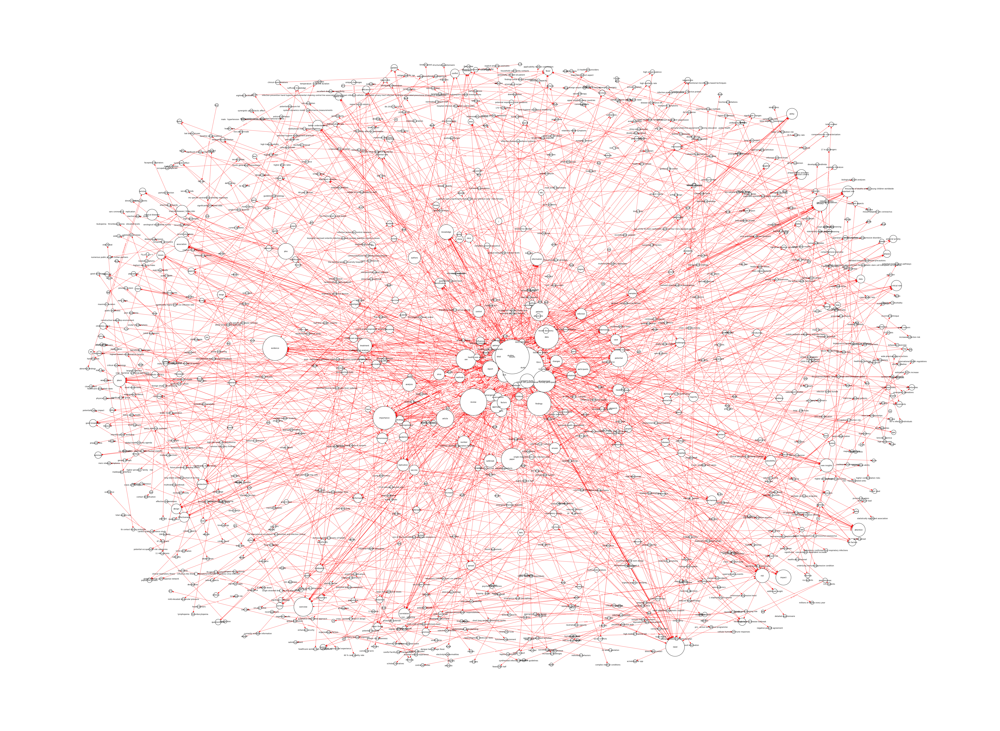

In [39]:
draw_kg(task_1_graph)

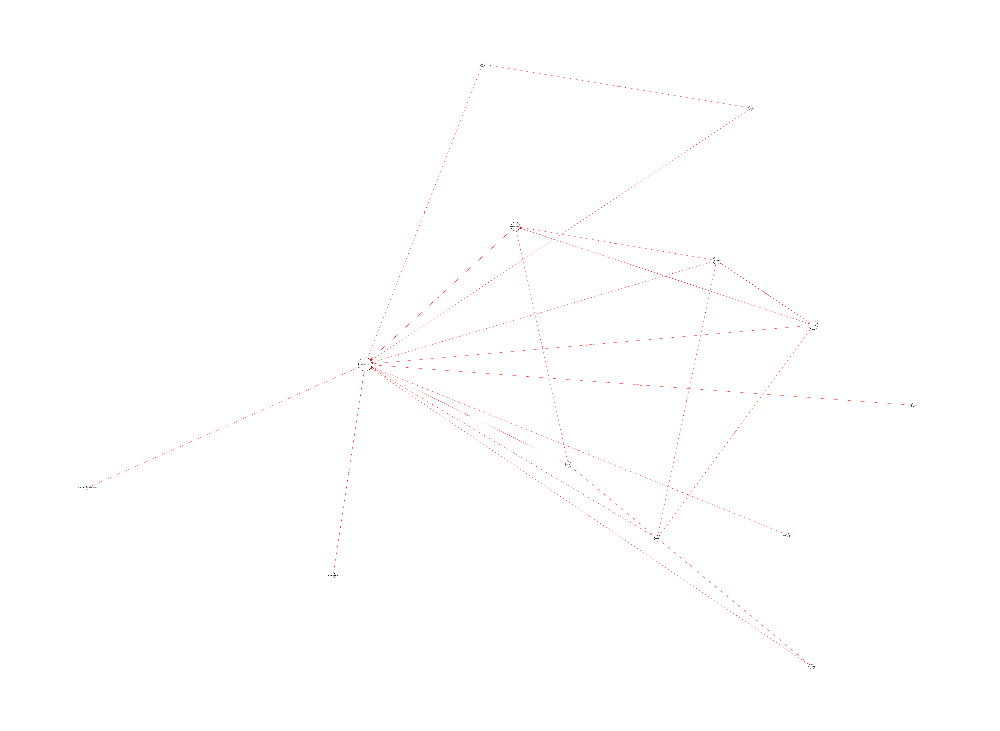

In [80]:
task_1_transmission = nx.ego_graph(task_1_graph, 'airborne transmission',2, undirected=True)
draw_kg(task_1_transmission)